<h1 class="heading">Wind Reconstructor</h1>
<h1>Preliminary testing of JSBSim - OpenFOAM integration</h1>

<h6 class="author"> — <b style="color:rgb(0,51,102);">Carmine Varriale, Agostino De Marco</b>, <i>University of Naples Federico II</i></h6>

## Introduction
In this Notebook, we are going show how it has been possible to couple two open source software applications, namely JSBSim and OpenFOAM, in order to obtain a first example of flight dynamics simulation in windy atmosphere. 

These result is the first achievement of a joint research project at _University of Naples Federico II (UniNa)_ and _Fraunhofer-Institut für Windenergie und Energiesystemtechnik (IWES)_ .

<br>
This Jupyter Notebook exploits a server software that asynchronously accepts positional data coming from several instances of JSBSim. Each JSBSim instance acts therefore as a client program, automatically executed in batch mode from the Notebook itself, which sends curerent aircraft position via socket to the server, and gets back local wind velocity components. The server interpolates atmospheric wind data over a pre-calculated flow field, which is stored in an OpenFOAM mesh structure.

In [1]:
% run ./python/nb_init.py
% matplotlib inline

import numpy as np

import geography as geo
import data_handling as dh
from property_map import pmap
from MCSim import *

In this test case, the mesh domain is rectangular with sides parallel to the North and East directions, so it coincides with its own bounding box. Also, it is symmetrical with respect to its origin.
From OpenFOAM function `checkMesh` we get:

In [2]:
# Grid bounding box UTM coords
E_min_m, N_min_m, H_min_m = (467190,     4517023,    0)             # m
E_max_m, N_max_m, H_max_m = (481911.172, 4523681.03, 1999.98772)    # m

# Origin of the grid reference frame
E_0_m = 0.5*(E_min_m + E_max_m)
N_0_m = 0.5*(N_min_m + N_max_m)

DE_m = E_max_m - E_min_m
DN_m = N_max_m - N_min_m

print("E_0_m =  {0:.0f} m, DEasting  = {1:.0f} m".format(E_0_m, DE_m), sep="")
print("N_0_m = {0:.0f} m, DNorthing =  {1:.0f} m".format(N_0_m, DN_m), sep="")

E_0_m =  474551 m, DEasting  = 14721 m
N_0_m = 4520352 m, DNorthing =  6658 m


where point coordinates are assumed to be in the <a href="https://en.wikipedia.org/wiki/Universal_Transverse_Mercator_coordinate_system">UTM</a> reference frame. Supposing we are in the northern emisphere, and approximately around $\lambda=40°$ and $L=14°$, we can easily derive the  zone number and latitude band designation by exploiting Python's `utm` library:

In [3]:
import utm
utm.from_latlon(40, 14)[2:4]

(33, 'T')

<img src="https://upload.wikimedia.org/wikipedia/commons/e/ed/Utm-zones.jpg" />
#### UTM zones designation

We can now use these references to correctly convert UTM easting and northing measures to latitude and longitude coordinates. Here is an example, for the origin of the mesh reference frame:

In [4]:
lat_0_deg, lon_0_deg = utm.to_latlon(E_0_m, N_0_m, 33, 'T')
print("Lat0 = {0:.3f}°, Lon0 = {1:.3f}°".format(lat_0_deg, lon_0_deg), sep="")

Lat0 = 40.834°, Lon0 = 14.698°


Finally, atmospheric wind is blowing from east to west, and an actuator disk has also been included for simplistic simulation of a wind turbine. Here are reported the plots for the three velocity components, in meters per second, at a constant altitude of 120m. 
<img src="images/09_Ux.png" />
#### ParaView: eastward component of velocity field in m/s, z = 120m

<img src="images/09_Uy.png" />
#### ParaView: northward component of velocity field in m/s, z = 120m

<img src="images/09_Uz.png" />
#### ParaView: upward component of velocity field in m/s, z = 120m

<br />
In order to test the new software architecture, we are now using a new Python class, which has been derived from the `SimFamily` one, that is able to handle multiple instances of JSBSim in background and make them visible to the server. This functionality is currently available only on Linux systems, though.

## Case 1: tailwind
Every aircraft in this case is placed in a fixed position on the western side of the grid, moving towards east. After $50$ seconds, each autopilot will start pursuing an heading of exactly $90°$. Altitude and speed are left free to evolve according to the aircraft natural dynamic modes.

In [5]:
N = 50
script     = 'c172x_OFtest_1'
autopilot  = 'c172ap_unina'
output_fol = 'c172x_OFtest_1'

# Creating instance of the class
Sim_test_1 = WRSimFamily(N, seed_name      = script,
                            autopilot_name = autopilot,
                            out_foldername = output_fol)

# Setting initial position from grid UTM coords
lat0_1, lon0_1 = utm.to_latlon(E_min_m, N_0_m, 33, 'T')

# Flight parameters 
h_ft    = Sim_test_1.generate_series('altitude', 'gaussian', (400,100))
psi_deg = Sim_test_1.generate_series('psi', 'gaussian', (90,30))
V_kts   = Sim_test_1.generate_series('vt', 'gaussian', (100,10))

# Initial position
lat0_1_mc = Sim_test_1.generate_series('latitude', 'gaussian',  (lat0_1,0.0))
lon0_1_mc = Sim_test_1.generate_series('longitude', 'gaussian', (lon0_1,0.0))

In [6]:
#Sim_test_1.launch_mc_sim(log='off', system='linux')

In [7]:
GrA = Sim_test_1.extract_post_group(list(range(1,N+1)),'A')
#GrA.get_traj_in_UTM()
GrA.load_traj_in_UTM()

Total time required: 83.39 s


In [8]:
GrA.plot_ground_track_UTM(origin=[E_0_m, N_0_m], ax_lim=list(0.55*np.asarray([-DE_m, DE_m, -DE_m, DE_m])), lbl_idx=-1)

Total time required: 0.97 s


Total time required: 3.63 s
Total time required: 0.70 s
Total time required: 0.59 s


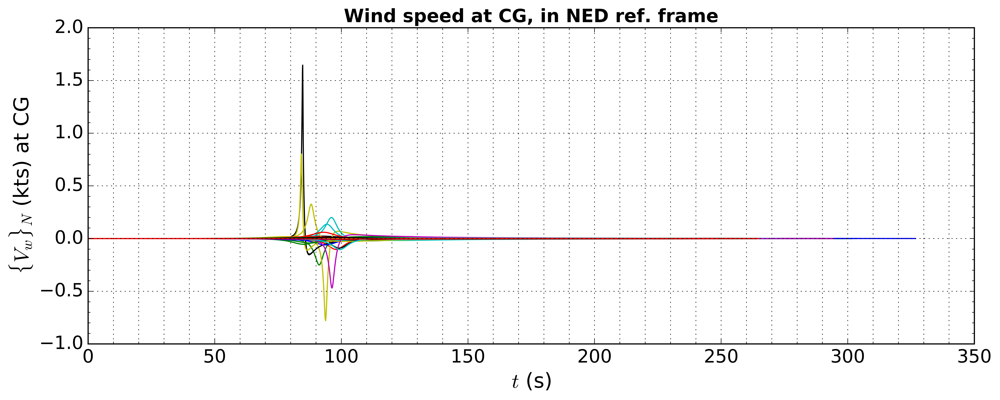

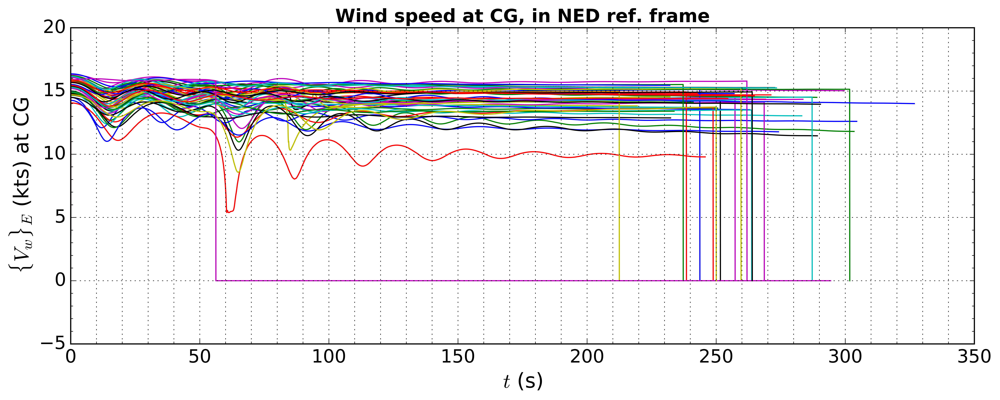

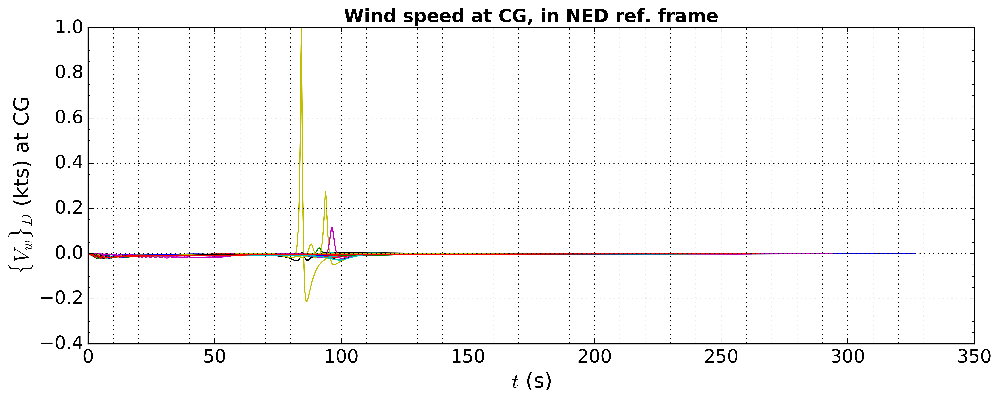

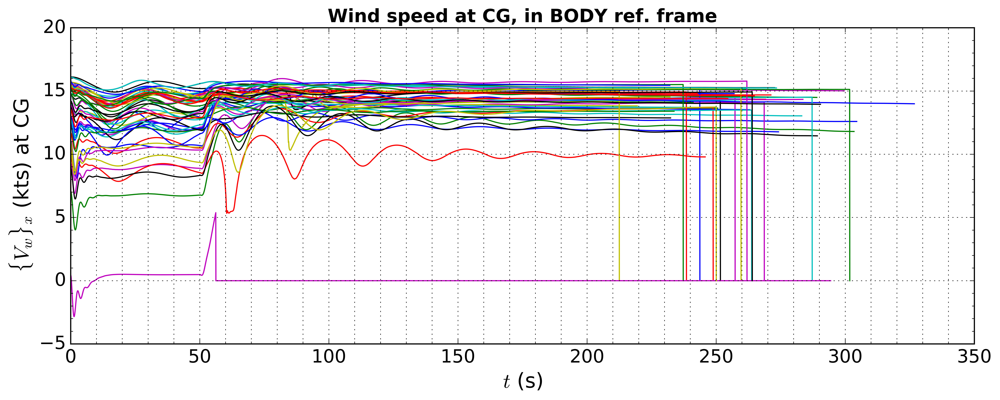

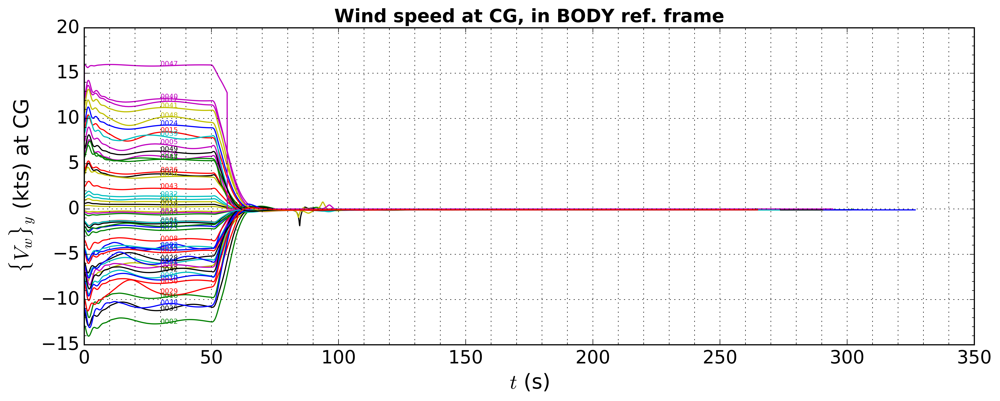

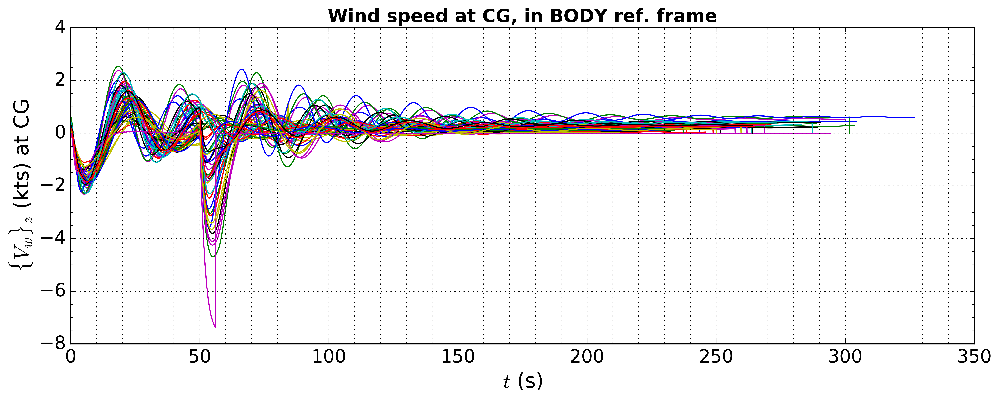

In [9]:
GrA.plot_vars('Vw_N_kts','Vw_E_kts','Vw_D_kts','Vw_x_kts')
GrA.plot_vars('Vw_y_kts', lbl_idx=600)
GrA.plot_vars('Vw_z_kts')

In [23]:
#GrA.plot_vars('h_sl_ft', lbl_idx=-1)
#GrA.plot_vars('alpha_deg','V_kts','Vg_kts','phi_deg','delta_a')

## Case 2: headwind
Every aircraft in this case is placed in a fixed position on the most eastern side of the grid, moving towards west. After $50$ seconds, each autopilot will start pursuing an heading of exactly $270°$. Altitude and speed are left free to evolve according to the aircraft natural dynamic modes.

In [11]:
script     = 'c172x_OFtest_2'
output_fol = 'c172x_OFtest_2'

# Creating instance of the class
Sim_test_2 = WRSimFamily(N, seed_name      = script,
                            autopilot_name = autopilot,
                            out_foldername = output_fol)

# Setting initial position from grid UTM coords
lat0_2, lon0_2 = utm.to_latlon(E_max_m, N_0_m, 33, 'T')

# Flight parameters 
h_ft    = Sim_test_2.generate_series('altitude', 'gaussian', (400,100))
psi_deg = Sim_test_2.generate_series('psi', 'gaussian', (270,30))
V_kts   = Sim_test_2.generate_series('vt', 'gaussian', (100,10))

# Initial position
lat0_2_mc = Sim_test_2.generate_series('latitude', 'gaussian',  (lat0_2,0.0))
lon0_2_mc = Sim_test_2.generate_series('longitude', 'gaussian', (lon0_2,0.0))

In [12]:
#Sim_test_2.launch_mc_sim(log='off', system='linux')

In [13]:
GrB = Sim_test_2.extract_post_group(list(range(1,N+1)),'B')
#GrB.get_traj_in_UTM()
GrB.load_traj_in_UTM()

Total time required: 134.94 s


In [14]:
GrB.plot_ground_track_UTM(origin=[E_0_m, N_0_m], ax_lim=list(0.55*np.asarray([-DE_m, DE_m, -DE_m, DE_m])), lbl_idx=-1)

Total time required: 0.90 s


Total time required: 0.53 s
Total time required: 0.62 s
Total time required: 4.71 s


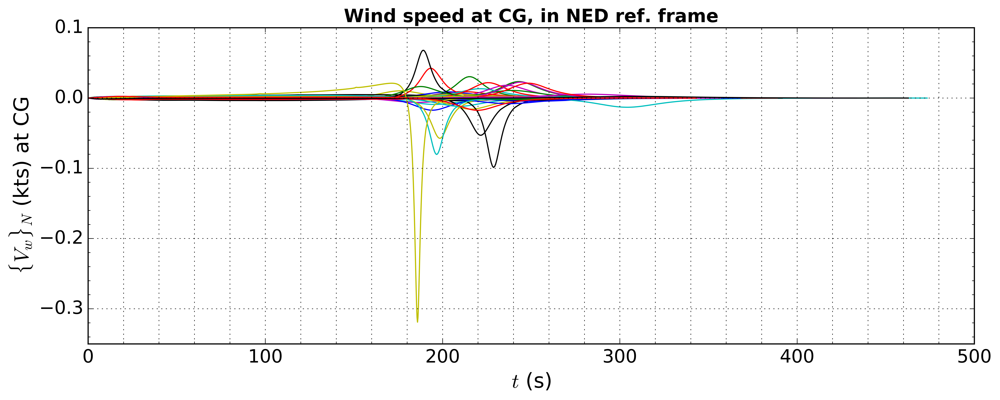

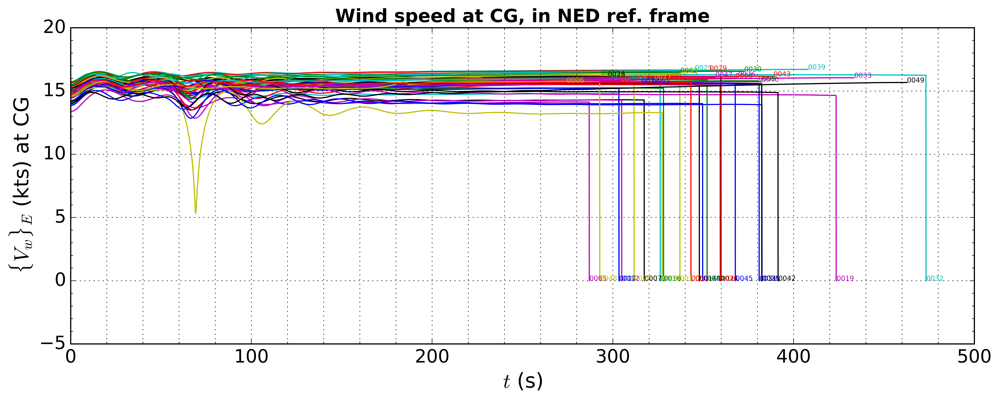

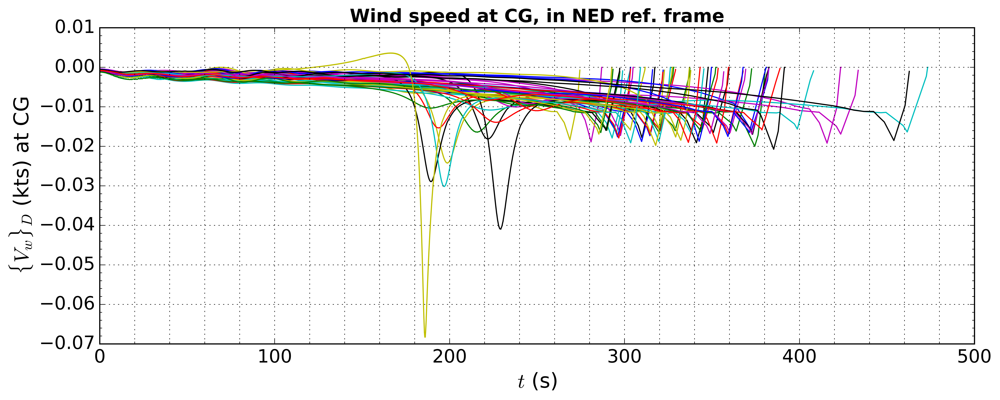

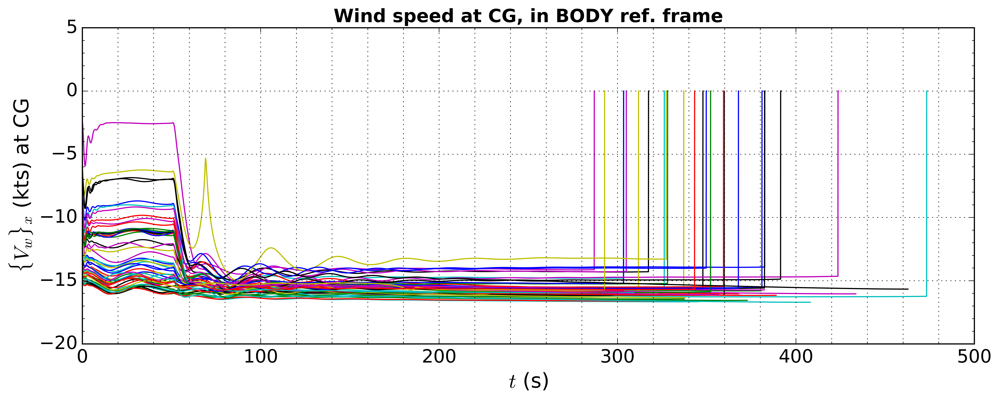

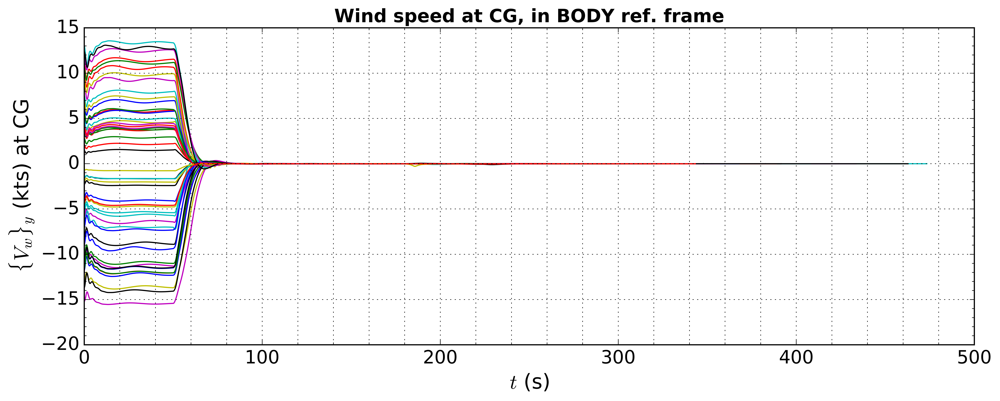

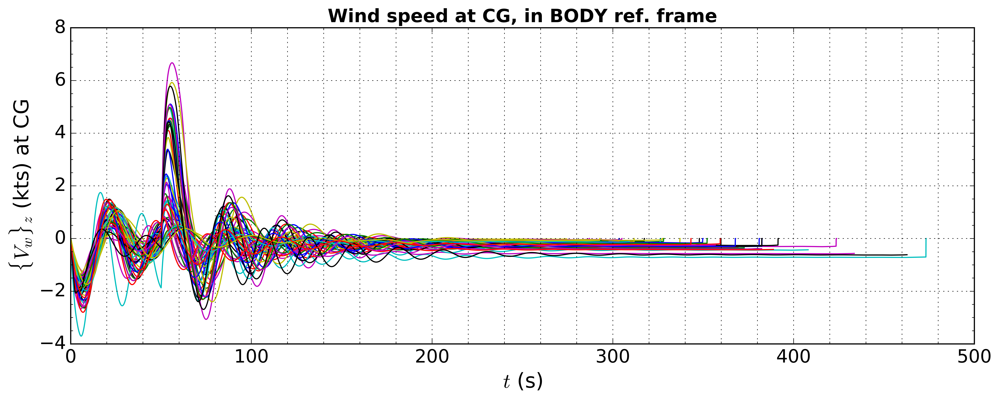

In [15]:
GrB.plot_vars('Vw_N_kts')
GrB.plot_vars('Vw_E_kts', lbl_idx=-1)
GrB.plot_vars('Vw_D_kts','Vw_x_kts','Vw_y_kts','Vw_z_kts')

In [24]:
#GrB.plot_vars('h_sl_ft', 'alpha_deg', 'V_kts', 'Vg_kts',lbl_idx=-1)
#GrB.plot_vars('phi_deg','delta_a')

## Case 3: crosswind
Every aircraft in this case is placed in a random position on the southern side of the grid, moving towards north. After $5$ seconds, each autopilot will start pursuing an heading of exactly $0°$. Altitude and speed are left free to evolve according to the aircraft natural dynamic modes.
#TODO: do not pursue heading, but waypoint aligned with intial position

In [17]:
script     = 'c172x_OFtest_3'
output_fol = 'c172x_OFtest_3'

# Creating instance of the class
Sim_test_3 = WRSimFamily(N, seed_name      = script,
                            autopilot_name = autopilot,
                            out_foldername = output_fol)

# Setting initial position from grid UTM coords
lat0_3, lon0_3 = utm.to_latlon(E_0_m, N_min_m, 33, 'T')
sigma_lon0_3   = 0.12*(lon0_2 - lon0_1)

# Flight parameters 
h_ft    = Sim_test_3.generate_series('altitude', 'gaussian', (400,100))
psi_deg = Sim_test_3.generate_series('psi', 'gaussian', (0,0))
V_kts   = Sim_test_3.generate_series('vt', 'gaussian', (80,10))

# Initial position
lat0_3_mc = Sim_test_3.generate_series('latitude',  'gaussian', (lat0_3,0.0))
lat0_3_mc = Sim_test_3.generate_series('longitude', 'gaussian', (lon0_3,sigma_lon0_3))

In [18]:
#Sim_test_3.launch_mc_sim(log='off', system='linux')

In [19]:
GrC = Sim_test_3.extract_post_group(list(range(1,N+1)),'C')
#GrC.get_traj_in_UTM()
GrC.load_traj_in_UTM()

Total time required: 73.00 s


In [20]:
GrC.plot_ground_track_UTM(origin=[E_0_m, N_0_m], ax_lim=list(0.55*np.asarray([-DE_m, DE_m, -DE_m, DE_m])), lbl_idx=-1)

Total time required: 1.97 s


Total time required: 6.20 s


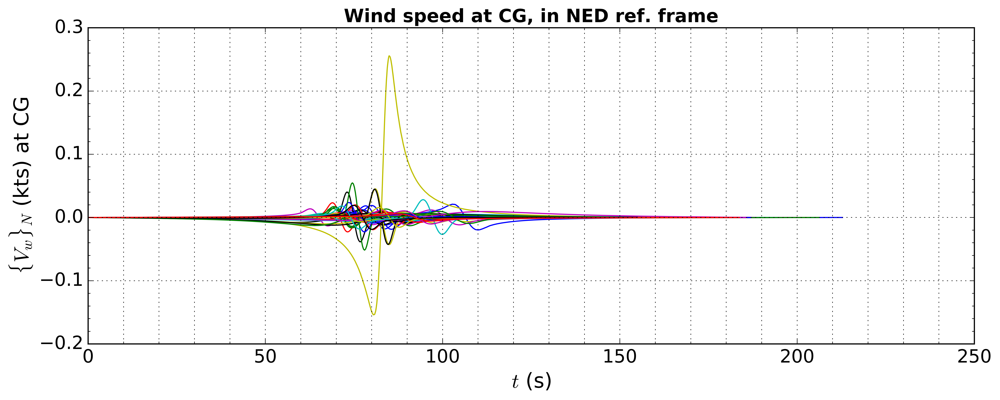

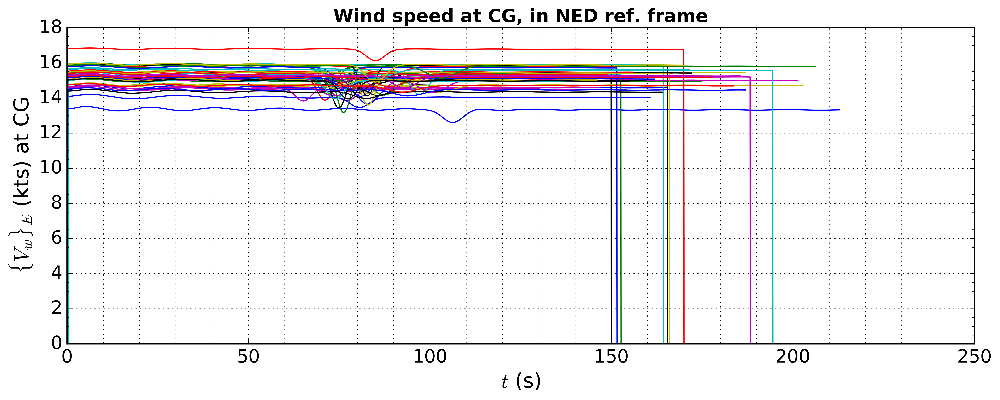

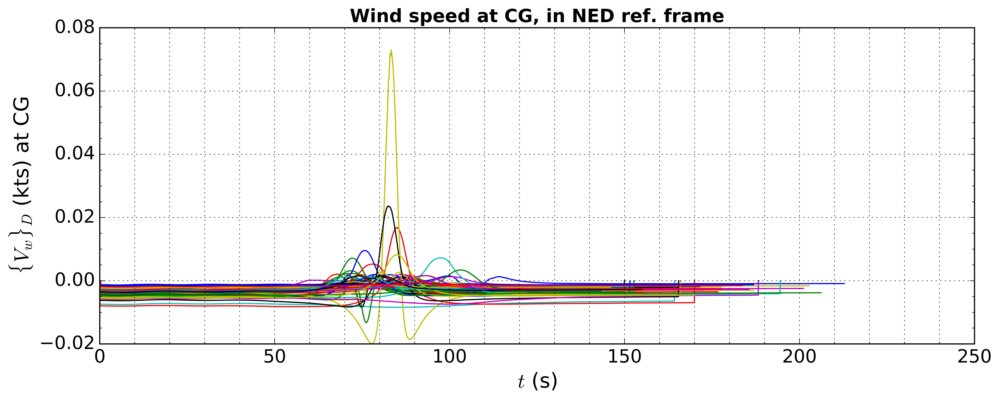

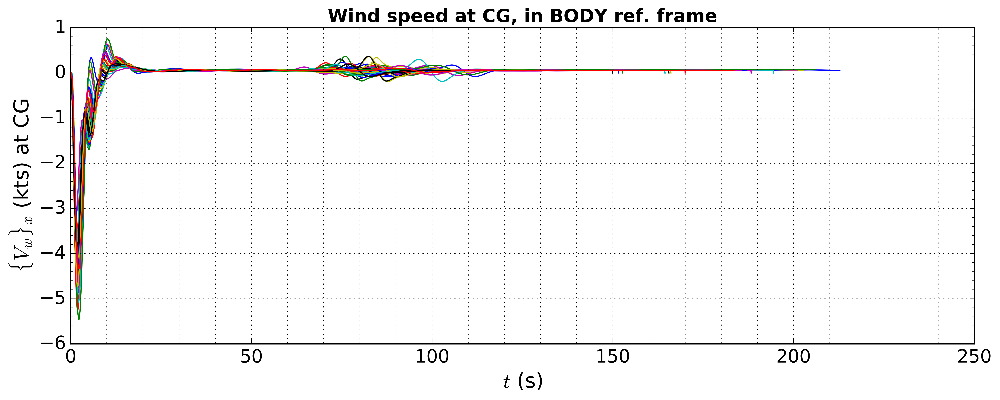

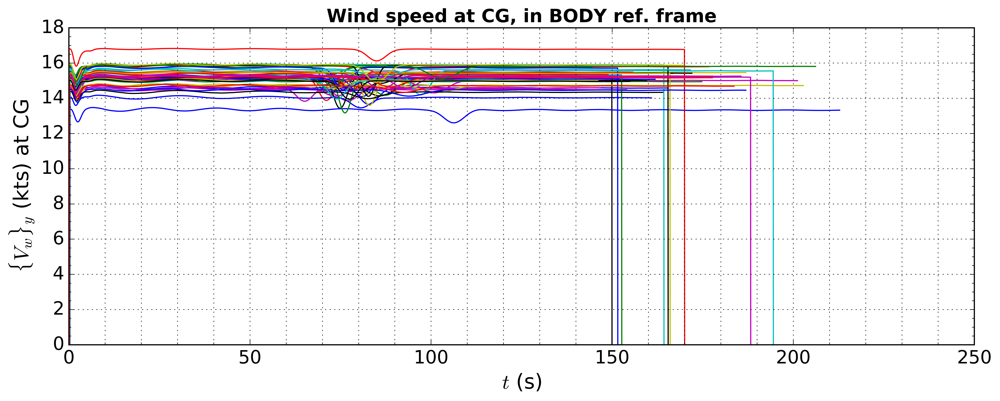

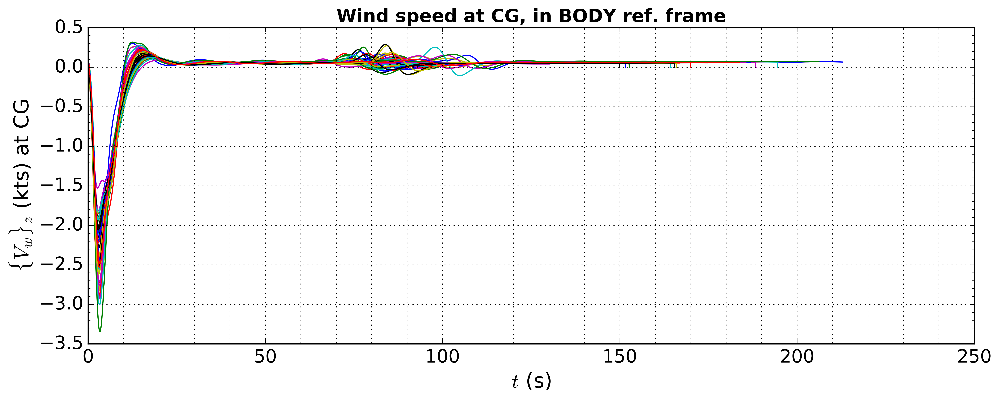

In [21]:
GrC.plot_vars('Vw_N_kts','Vw_E_kts','Vw_D_kts','Vw_x_kts','Vw_y_kts','Vw_z_kts')

In [28]:
#GrC.plot_vars('h_sl_ft', 'alpha_deg', 'V_kts', 'Vg_kts',lbl_idx=-1)
#GrC.plot_vars('phi_deg','delta_a')